In [1]:
import numpy as np
import pandas as pd
import re
import plotly.graph_objects as go
from plotly.subplots import make_subplots

## Import Data

In [2]:
loan_data_backup = pd.read_csv("loan_data_2007_2014.csv")
loan_data = loan_data_backup.copy()

/home/olumide/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3071: DtypeWarning: Columns (20) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [3]:
# Make Pandas show us all the columns
pd.options.display.max_columns = None
loan_data.head(50)

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m
0,0,1077501,1296599,5000,5000,4975.00000,36 months,10.65,162.87,B,B2,NaN,10+ years,RENT,24000.00,Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-85,1.0,NaN,NaN,3.0,0.0,13648,83.70,9.0,f,0.00,0.00,5861.071414,5831.78,5000.00,861.07,0.00,0.00,0.0000,Jan-15,171.62,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1077430,1314167,2500,2500,2500.00000,60 months,15.27,59.83,C,C4,Ryder,< 1 year,RENT,30000.00,Source Verified,Dec-11,Charged Off,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0.0,Apr-99,5.0,NaN,NaN,3.0,0.0,1687,9.40,4.0,f,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.1100,Apr-13,119.66,NaN,Sep-13,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,1077175,1313524,2400,2400,2400.00000,36 months,15.96,84.33,C,C5,NaN,10+ years,RENT,12252.00,Not Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,NaN,small_business,real estate business,606xx,IL,8.72,0.0,Nov-01,2.0,NaN,NaN,2.0,0.0,2956,98.50,10.0,f,0.00,0.00,3003.653644,3003.65,2400.00,603.65,0.00,0.00,0.0000,Jun-14,649.91,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,1076863,1277178,10000,10000,10000.00000,36 months,13.49,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.00,Source Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0.0,Feb-96,1.0,35.0,NaN,10.0,0.0,5598,21.00,37.0,f,0.00,0.00,12226.302210,12226.30,10000.00,2209.33,16.97,0.00,0.0000,Jan-15,357.48,NaN,Jan-15,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,1075358,1311748,3000,3000,3000.00000,60 months,12.69,67.79,B,B5,University Medical Group,1 year,RENT,80000.00,Source Verified,Dec-11,Current,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/21/11 > I plan on combi...,other,Personal,972xx,OR,17.94,0.0,Jan-96,0.0,38.0,NaN,15.0,0.0,27783,53.90,38.0,f,766.90,766.90,3242.170000,3242.17,2233.10,1009.07,0.00,0.00,0.0000,Jan-16,67.79,Feb-16,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,5,1075269,1311441,5000,5000,5000.00000,36 months,7.90,156.46,A,A4,Veolia Transportaton,3 years,RENT,36000.00,Source Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,NaN,wedding,My wedding loan I promise to pay back,852xx,AZ,11.20,0.0,Nov-04,3.0,NaN,NaN,9.0,0.0,7963,28.30,12.0,f,0.00,0.00,5631.377753,5631.38,5000.00,631.38,0.00,0.00,0.0000,Jan-15,161.03,NaN,Sep-15,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,6,1069639

In [4]:
# See more info, inluding about data types of the columns
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 466285 entries, 0 to 466284
Data columns (total 75 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   Unnamed: 0                   466285 non-null  int64  
 1   id                           466285 non-null  int64  
 2   member_id                    466285 non-null  int64  
 3   loan_amnt                    466285 non-null  int64  
 4   funded_amnt                  466285 non-null  int64  
 5   funded_amnt_inv              466285 non-null  float64
 6   term                         466285 non-null  object 
 7   int_rate                     466285 non-null  float64
 8   installment                  466285 non-null  float64
 9   grade                        466285 non-null  object 
 10  sub_grade                    466285 non-null  object 
 11  emp_title                    438697 non-null  object 
 12  emp_length                   445277 non-null  object 
 13 

## General Preprocessing

### Utilities

In [5]:
def extract_integer(x):
    ans = re.findall(re.compile(r'\d+'), str(x))
    if ans != []:
        return np.int64(ans.pop()) # Although, the turtor made it np.float64 via pd.numeric()
    else:
        return np.int64(0)

#### Preprocess Discrete Variables

In [6]:
# Show what the values in the column are
loan_data["emp_length"].unique()

loan_data["emp_length_int"] = loan_data["emp_length"].map(extract_integer)
loan_data["emp_length_int"].unique()


array([10,  1,  3,  8,  9,  4,  5,  6,  2,  7,  0])

In [7]:

# Change string fornat (e.g., 'Jan-85') of "earliest_cr_line"
# to datetime datatype.

# NOTE Lowercase %y ==> year in two-digit format vs. %Y ==> year
# in four-digit format.

loan_data["earliest_cr_line_date"] = pd.to_datetime(loan_data["earliest_cr_line"], format="%b-%y")

# We need number of days or months that's passed since the 
# earliest credit line was issued, referenced to today's date.
# NOTE Update the code to pick today's date from the system.

days_passed_in_months = \
    (pd.to_datetime("2017-12-01") - loan_data["earliest_cr_line_date"]) / np.timedelta64(1,"M")
loan_data["mths_since_earliest_cr_line"] = round(pd.to_numeric(days_passed_in_months))

loan_data["mths_since_earliest_cr_line"].describe()

count    466256.000000
mean        239.482430
std          93.974829
min        -612.000000
25%         183.000000
50%         225.000000
75%         285.000000
max         587.000000
Name: mths_since_earliest_cr_line, dtype: float64

In [8]:
# ! The minum value is negative. The time differences in months
# should not be. Let's investigate.

cols_to_investigate = ["earliest_cr_line", "earliest_cr_line_date", "mths_since_earliest_cr_line"]
loan_data.loc[:, cols_to_investigate][loan_data.mths_since_earliest_cr_line < 0]

,earliest_cr_line,earliest_cr_line_date,mths_since_earliest_cr_line
1580,Sep-62,2062-09-01,-537.0
1770,Sep-68,2068-09-01,-609.0
2799,Sep-64,2064-09-01,-561.0
3282,Sep-67,2067-09-01,-597.0
3359,Feb-65,2065-02-01,-566.0
...,...,...,...
464003,Jan-68,2068-01-01,-601.0
464260,Jul-66,2066-07-01,-583.0
465100,Oct-67,2067-10-01,-598.0
465500,Sep-67,2067-09-01,-597.0


In [9]:
# NOTE the inability of the logic to decipher previous or present 
# century from the two-digit year format.

# One Band-Aid solution is asigning the -ve values with the 
# "correctly-calculated month, fartheest back, any of the credit 
# lines was issued", i.e., max() of the mths_since_earliest_cr_line 
# column. *sigh*

loan_data["mths_since_earliest_cr_line"][loan_data["mths_since_earliest_cr_line"] < 0] = \
    loan_data["mths_since_earliest_cr_line"].max()  

min(loan_data["mths_since_earliest_cr_line"])

<ipython-input-9-8436a63ed087>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loan_data["mths_since_earliest_cr_line"][loan_data["mths_since_earliest_cr_line"] < 0] = \


73.0

In [10]:
# Same for 'term' and 'issue_d'

loan_data["term_int"] = pd.to_numeric(loan_data["term"].map(extract_integer))

loan_data["issue_d_date"] = pd.to_datetime(loan_data["issue_d"], format="%b-%y")
days_passed_in_months = \
    (pd.to_datetime("2017-12-01") - loan_data["issue_d_date"]) / np.timedelta64(1,"M")
loan_data["mths_since_issue_d"] = round(pd.to_numeric(days_passed_in_months))

loan_data["mths_since_issue_d"].describe()

count    466285.000000
mean         51.255187
std          14.340154
min          36.000000
25%          41.000000
50%          47.000000
75%          57.000000
max         126.000000
Name: mths_since_issue_d, dtype: float64

#### Preprocess Continuous Variables

In [11]:
# On-hot encoding for all categorical variables. NOTE that the
# categories become column names in the returned frame.
# However, we can create more descriptive names by prefixing
# with some text. See below.

pd.get_dummies(loan_data["grade"], prefix="grade", prefix_sep=":")

# We do the same for all other categorical variables and concat 
# them into a new frame. This can then be concat with the
# original dataset frame.

loan_data_dummies = [pd.get_dummies(loan_data["grade"], prefix="grade", prefix_sep=":"),
                    pd.get_dummies(loan_data["sub_grade"], prefix="sub_grade", prefix_sep=":"),
                    pd.get_dummies(loan_data["home_ownership"], prefix="home_ownership", prefix_sep=":"),
                    pd.get_dummies(loan_data["verification_status"], prefix="verification_status", prefix_sep=":"),
                    pd.get_dummies(loan_data["loan_status"], prefix="loan_status", prefix_sep=":"),
                    pd.get_dummies(loan_data["purpose"], prefix="purpose", prefix_sep=":"),
                    pd.get_dummies(loan_data["addr_state"], prefix="addr_state", prefix_sep=":"),
                    pd.get_dummies(loan_data["initial_list_status"], prefix="initial_list_status", prefix_sep=":")]

loan_data_dummies = pd.concat(loan_data_dummies, axis=1)
loan_data = pd.concat([loan_data, loan_data_dummies], axis=1)

# Check the updates

loan_data.columns.values

array(['Unnamed: 0', 'id', 'member_id', 'loan_amnt', 'funded_amnt',
       'funded_amnt_inv', 'term', 'int_rate', 'installment', 'grade',
       'sub_grade', 'emp_title', 'emp_length', 'home_ownership',
       'annual_inc', 'verification_status', 'issue_d', 'loan_status',
       'pymnt_plan', 'url', 'desc', 'purpose', 'title', 'zip_code',
       'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'mths_since_last_delinq',
       'mths_since_last_record', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'initial_list_status', 'out_prncp',
       'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee',
       'recoveries', 'collection_recovery_fee', 'last_pymnt_d',
       'last_pymnt_amnt', 'next_pymnt_d', 'last_credit_pull_d',
       'collections_12_mths_ex_med', 'mths_since_last_major_derog',
       'policy_code', 'application_type', 'annual_inc_joint', 'dti_joint',
       'veri

#### Checking For Missing Values

In [12]:
# The following insicates by True, every cell that's
# empty or nan.

#loan_data.isnull()

In [13]:
# Display all rows
pd.options.display.max_rows = None

# But how many in each column are empty / nan?
loan_data.isnull().sum()

Unnamed: 0                                                              0
id                                                                      0
member_id                                                               0
loan_amnt                                                               0
funded_amnt                                                             0
funded_amnt_inv                                                         0
term                                                                    0
int_rate                                                                0
installment                                                             0
grade                                                                   0
sub_grade                                                               0
emp_title                                                           27588
emp_length                                                          21008
home_ownership                        

In [14]:
# 1. Replace missing values in total_rev_hi_lim with the
#    corresponding loan funded amount, 'funded_amnt'. Make
#    the replacement directly in the total_rev_hi_lim.

loan_data["total_rev_hi_lim"].fillna(loan_data["funded_amnt"], inplace=True)
loan_data["total_rev_hi_lim"].isnull().sum()

0

In [15]:
# 2. Replace missing values in annual_inc with mean of the
#    non-null values.

loan_data["annual_inc"].fillna(loan_data["annual_inc"].mean(), inplace=True)
loan_data["annual_inc"].isnull().sum()

0

In [16]:
# 3. Replace missing values in the other discrete variables
#    with 0

#loan_data[["mths_since_earliest_cr_line", "acc_now_delinq", "total_acc", "pub_rec"]] = \
#    loan_data[["mths_since_earliest_cr_line", "acc_now_delinq", "total_acc", "pub_rec"]].fillna(0, inplace=True)

#loan_data[["open_acc", "inq_last_6mths", "delinq_2yrs"]] = \
#    loan_data[["open_acc", "inq_last_6mths", "delinq_2yrs"]].fillna(0, inplace=True)

# loan_data[["acc_now_delinq", "total_acc", "pub_rec"]] = \
#    loan_data[["acc_now_delinq", "total_acc", "pub_rec"]].fillna(0, inplace=True)

# loan_data[["open_acc", "inq_last_6mths"]] = \
#    loan_data[["open_acc", "inq_last_6mths"]].fillna(0, inplace=True)

# PD Model

In [17]:
loan_data['loan_status'].unique()

array(['Fully Paid', 'Charged Off', 'Current', 'Default',
       'Late (31-120 days)', 'In Grace Period', 'Late (16-30 days)',
       'Does not meet the credit policy. Status:Fully Paid',
       'Does not meet the credit policy. Status:Charged Off'],
      dtype=object)

In [18]:
# NOTE
# Good: Fully Paid; Current; In Grace Period
# Bad: Charged Off; Default; Late (31-120 days); Does not meet the credit policy. Status:Charged Off 

# Let's see the distribution of loan_status types
loan_data['loan_status'].value_counts()

Current                                                224226
Fully Paid                                             184739
Charged Off                                             42475
Late (31-120 days)                                       6900
In Grace Period                                          3146
Does not meet the credit policy. Status:Fully Paid       1988
Late (16-30 days)                                        1218
Default                                                   832
Does not meet the credit policy. Status:Charged Off       761
Name: loan_status, dtype: int64

In [19]:
# Establish dependent variable, Y

bad = ["Charged Off", "Default", "Late (31-120 days)", "Does not meet the credit policy. Status:Charged Off"]
loan_data['good_bad'] = np.where(loan_data['loan_status'].isin(bad), 0, 1)

loan_data['good_bad'].head()

0    1
1    0
2    1
3    1
4    1
Name: good_bad, dtype: int64

#### Discrete Variables: Compute Weight of Evidence (WoE) and Information Value (IV)

In [20]:
# NOTE See Course Videos 29 - 31

# WoE function for discrete unordered variables
def woe_discrete(df, discrete_variable_name, good_bad_variable_df):

    """
    Function computes WoE for a discrete independent variable given some dataset (w/o the target variable(s)),
    the variable name, and another dataset comprising only target variable(s).

    """

    df = pd.concat([df[discrete_variable_name], good_bad_variable_df], axis = 1)
    df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
                    df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
    df = df.iloc[:, [0, 1, 3]]
    df.columns = [df.columns.values[0], 'n_obs', 'prop_good']
    df['prop_n_obs'] = df['n_obs'] / df['n_obs'].sum()
    df['n_good'] = df['prop_good'] * df['n_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['n_obs']
    df['prop_n_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_n_bad'] = df['n_bad'] / df['n_bad'].sum()
    df['WoE'] = np.log(df['prop_n_good'] / df['prop_n_bad'])
    df = df.sort_values(['WoE'])
    df = df.reset_index(drop = True)
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    df['IV'] = (df['prop_n_good'] - df['prop_n_bad']) * df['WoE']
    df['IV'] = df['IV'].sum()

    df = df[[discrete_variable_name,"n_obs","WoE"]]
    df.columns = [discrete_variable_name, "No. of Observations", discrete_variable_name + ":WoE"]

    return df

In [21]:
# We test the function with the 'grade' variable.

df_temp = woe_discrete(loan_data.drop('good_bad', axis = 1), 'grade', loan_data["good_bad"])
# We execute the function we defined with the necessary arguments: a dataframe, a string, and a dataframe.
# We store the result in a dataframe.
df_temp

,grade,No. of Observations,grade:WoE
0,G,3322,-1.144166
1,F,13229,-0.952214
2,E,35757,-0.678466
3,D,76888,-0.395001
4,C,125293,-0.055251
5,B,136929,0.364043
6,A,74867,1.114730


In [22]:
def plotter(df):

    """
    Function to plot WoE and NoObs given a dataset.

    """

    var_name = df.columns.values[0]
    fig = make_subplots(rows=1, cols=2, subplot_titles=("", ""))
    fig.add_trace(go.Scatter(x=df["{}".format(var_name)], y=df["{}:WoE".format(var_name)], name="Weight of Evidence"), row=1, col=1)
    fig.add_trace(go.Scatter(x=df["{}".format(var_name)], y=df["No. of Observations"], name="Distribution of Observations"), row=1, col=2)

    fig.update_xaxes(title_text="{}".format(var_name), row=1, col=1)
    fig.update_yaxes(title_text="WoE", row=1, col=1)

    fig.update_xaxes(title_text="{}".format(var_name), row=1, col=2)
    fig.update_yaxes(title_text="No. of Observations", row=1, col=2)

    fig.show()

plotter(df_temp)

# NOTE Clearly, the grades are distinguished by WoE. Although a 
# "weak" case could be made for aggregating G and F categories
# considering the NoObs in G relative to F and much closer WoE.
# 
# However, we'll go with not aggregating, and also note category G
# as our reference category or benchmark for the grade variable.

In [23]:
# For 'home_ownership' variable

df_temp = woe_discrete(loan_data.drop('good_bad', axis = 1), 'home_ownership', loan_data["good_bad"])
df_temp.head()

,home_ownership,No. of Observations,home_ownership:WoE
0,OTHER,182,-0.765617
1,NONE,50,-0.439616
2,RENT,188473,-0.161980
3,OWN,41704,0.010764
4,MORTGAGE,235875,0.144832


In [24]:

plotter(df_temp)

# NOTE In this case, while the WoE is fairly evenly distributed,
# there is a strong case for aggregating categories OTHER, NONE, 
# and ANY. In the turtorial, all 3 are aggregated with RENT.
# 
# However, I disagree. But we'll keep in-line with the turorial.
# 
# Also, note that because ANY has only 1 observation, the
# computation for WoE yields Inf. Hence, it's not plotted.
# 
# REcall, the following dummies had been created previously. See
# code very ealy on. 

loan_data['home_ownership:RENT_OTHER_NONE_ANY'] = sum([loan_data['home_ownership:RENT'], loan_data['home_ownership:OTHER'],
                                                      loan_data['home_ownership:NONE'],loan_data['home_ownership:ANY']])

# According to the tutorial, we combine them in one category, 
# 'RENT_OTHER_NONE_ANY' and end-up with 3 categories: 
# 'RENT_OTHER_NONE_ANY', 'OWN', 'MORTGAGE'.
# 
# 'RENT_OTHER_NONE_ANY' will be the reference category.

In [25]:
# For 'addr_state' variable

loan_data['addr_state'].unique()

# NOTE how ND is not among the US states.

array(['AZ', 'GA', 'IL', 'CA', 'OR', 'NC', 'TX', 'VA', 'MO', 'CT', 'UT',
       'FL', 'NY', 'PA', 'MN', 'NJ', 'KY', 'OH', 'SC', 'RI', 'LA', 'MA',
       'WA', 'WI', 'AL', 'CO', 'KS', 'NV', 'AK', 'MD', 'WV', 'VT', 'MI',
       'DC', 'SD', 'NH', 'AR', 'NM', 'MT', 'HI', 'WY', 'OK', 'DE', 'MS',
       'TN', 'IA', 'NE', 'ID', 'IN', 'ME'], dtype=object)

In [26]:
df_temp = woe_discrete(loan_data.drop('good_bad', axis = 1), 'addr_state', loan_data["good_bad"])
df_temp

,addr_state,No. of Observations,addr_state:WoE
0,NE,14,-2.385526
1,IA,14,-0.798561
2,NV,6519,-0.258574
3,HI,2487,-0.163373
4,FL,31637,-0.155217
5,AL,5853,-0.138392
6,NY,40242,-0.074932
7,LA,5489,-0.072784
8,NM,2588,-0.062417
9,OK,4117,-0.060871


In [27]:
plotter(df_temp)

In [28]:
if ['addr_state:ND'] in loan_data.columns.values:
    pass
else:
    loan_data['addr_state:ND'] = 0

# After addressing the isseu with ND, lets drill-down some
# more (i.e., elbow analysis) by censuring NE, NV at the 
# LHS and D, WV at the RHS.

plotter(df_temp.iloc[2: -2, : ])

# More drill-down can be done, from where justification is
# provided in the tutorial for the final aggregation scheme.

#plotter(df_temp.iloc[6: -6, : ])  

In [29]:
# Final aggregationscheme for the addr_state variable:

# 'ND' 'NE' 'IA' NV' 'FL' 'HI' 'AL'
# 'NM' 'VA'
# 'NY'
# 'OK' 'TN' 'MO' 'LA' 'MD' 'NC'
# 'CA'
# 'UT' 'KY' 'AZ' 'NJ'
# 'AR' 'MI' 'PA' 'OH' 'MN'
# 'RI' 'MA' 'DE' 'SD' 'IN'
# 'GA' 'WA' 'OR'
# 'WI' 'MT'
# 'TX'
# 'IL' 'CT'
# 'KS' 'SC' 'CO' 'VT' 'AK' 'MS'
# 'WV' 'NH' 'WY' 'DC' 'ME' 'ID'

# 'IA_NV_HI_ID_AL_FL' will be the reference category.

loan_data['addr_state:ND_NE_IA_NV_FL_HI_AL'] = sum([loan_data['addr_state:ND'], loan_data['addr_state:NE'],
                                               loan_data['addr_state:IA'], loan_data['addr_state:NV'],
                                               loan_data['addr_state:FL'], loan_data['addr_state:HI'],
                                               loan_data['addr_state:AL']])

loan_data['addr_state:NM_VA'] = sum([loan_data['addr_state:NM'], loan_data['addr_state:VA']])

loan_data['addr_state:OK_TN_MO_LA_MD_NC'] = sum([loan_data['addr_state:OK'], loan_data['addr_state:TN'],
                                            loan_data['addr_state:MO'], loan_data['addr_state:LA'],
                                            loan_data['addr_state:MD'], loan_data['addr_state:NC']])

loan_data['addr_state:UT_KY_AZ_NJ'] = sum([loan_data['addr_state:UT'], loan_data['addr_state:KY'],
                                      loan_data['addr_state:AZ'], loan_data['addr_state:NJ']])

loan_data['addr_state:AR_MI_PA_OH_MN'] = sum([loan_data['addr_state:AR'], loan_data['addr_state:MI'],
                                         loan_data['addr_state:PA'], loan_data['addr_state:OH'],
                                         loan_data['addr_state:MN']])

loan_data['addr_state:RI_MA_DE_SD_IN'] = sum([loan_data['addr_state:RI'], loan_data['addr_state:MA'],
                                         loan_data['addr_state:DE'], loan_data['addr_state:SD'],
                                         loan_data['addr_state:IN']])

loan_data['addr_state:GA_WA_OR'] = sum([loan_data['addr_state:GA'], loan_data['addr_state:WA'],
                                   loan_data['addr_state:OR']])

loan_data['addr_state:WI_MT'] = sum([loan_data['addr_state:WI'], loan_data['addr_state:MT']])

loan_data['addr_state:IL_CT'] = sum([loan_data['addr_state:IL'], loan_data['addr_state:CT']])

loan_data['addr_state:KS_SC_CO_VT_AK_MS'] = sum([loan_data['addr_state:KS'], loan_data['addr_state:SC'],
                                            loan_data['addr_state:CO'], loan_data['addr_state:VT'],
                                            loan_data['addr_state:AK'], loan_data['addr_state:MS']])

loan_data['addr_state:WV_NH_WY_DC_ME_ID'] = sum([loan_data['addr_state:WV'], loan_data['addr_state:NH'],
                                            loan_data['addr_state:WY'], loan_data['addr_state:DC'],
                                            loan_data['addr_state:ME'], loan_data['addr_state:ID']])

#### Dummie-rize remaining discrete variables

In [30]:
# See Video 31. "...Homework"

# NOTE Only 'purpose' if further aggregated. 

# df_temp = woe_discrete(loan_data.drop('good_bad', axis = 1), 'verification_status', loan_data["good_bad"])
# df_temp
# plotter(df_temp)

# df_temp = woe_discrete(loan_data.drop('good_bad', axis = 1), 'initial_list_status', loan_data["good_bad"])
# df_temp
# plotter(df_temp)

df_temp = woe_discrete(loan_data.drop('good_bad', axis = 1), 'purpose', loan_data["good_bad"])
#df_temp
plotter(df_temp)

In [31]:
loan_data['purpose:educ__sm_b__wedd__ren_en__mov__house'] = sum([loan_data['purpose:educational'], loan_data['purpose:small_business'],
                                                                 loan_data['purpose:wedding'], loan_data['purpose:renewable_energy'],
                                                                 loan_data['purpose:moving'], loan_data['purpose:house']])
loan_data['purpose:oth__med__vacation'] = sum([loan_data['purpose:other'], loan_data['purpose:medical'],
                                             loan_data['purpose:vacation']])
loan_data['purpose:major_purch__car__home_impr'] = sum([loan_data['purpose:major_purchase'], loan_data['purpose:car'],
                                                        loan_data['purpose:home_improvement']])

#### Continuous Variables: Quantize / Bin

In [32]:
# NOTE See Course Video 32

# WoE function for continuous (and actually, discrete) ordered variables

def woe_ordered_continuous(df, discrete_variable_name, good_bad_variable_df):

    """
    Function computes WoE, differing with woe_discrete with just two
    line, which by the way are commented out.

    """

    df = pd.concat([df[discrete_variable_name], good_bad_variable_df], axis = 1)
    df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
                    df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
    df = df.iloc[:, [0, 1, 3]]
    df.columns = [df.columns.values[0], 'n_obs', 'prop_good']
    df['prop_n_obs'] = df['n_obs'] / df['n_obs'].sum()
    df['n_good'] = df['prop_good'] * df['n_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['n_obs']
    df['prop_n_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_n_bad'] = df['n_bad'] / df['n_bad'].sum()
    df['WoE'] = np.log(df['prop_n_good'] / df['prop_n_bad'])
    # df = df.sort_values(['WoE'])
    # df = df.reset_index(drop = True)
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    df['IV'] = (df['prop_n_good'] - df['prop_n_bad']) * df['WoE']
    df['IV'] = df['IV'].sum()

    df = df[[discrete_variable_name,"n_obs","WoE"]]
    df.columns = [discrete_variable_name, "No. of Observations", discrete_variable_name + ":WoE"]

    return df

In [33]:
# For 'term_int' variable. Note that there are just two categorories, 30 and 60. 

df_temp = woe_ordered_continuous(loan_data.drop('good_bad', axis = 1), 'term_int', loan_data["good_bad"])
df_temp

,term_int,No. of Observations,term_int:WoE
0,36,337953,0.132203
1,60,128332,-0.294894


In [34]:
plotter(df_temp)

In [35]:
# NOTE '60' will be the reference category.

loan_data['term:36'] = np.where((loan_data['term_int'] == 36), 1, 0)
loan_data['term:60'] = np.where((loan_data['term_int'] == 60), 1, 0)

In [36]:
# For 'term_int' variable. Note that there are just two categorories, 30 and 60. 

df_temp = woe_ordered_continuous(loan_data.drop('good_bad', axis = 1), 'emp_length_int', loan_data["good_bad"])
df_temp

,emp_length_int,No. of Observations,emp_length_int:WoE
0,0,21008,-0.219821
1,1,65887,-0.064919
2,2,41373,-0.004624
3,3,36596,-0.002192
4,4,28023,-0.002893
5,5,30774,-0.056866
6,6,26112,-0.077766
7,7,26180,-0.020764
8,8,22395,-0.007810
9,9,17888,-0.028239


In [37]:
plotter(df_temp)

In [38]:
# We create the following categories: '0', '1', '2 - 4', '5 - 6', '7 - 9', '10'
# '0' will be the reference category

loan_data['emp_length:0'] = np.where(loan_data['emp_length_int'].isin([0]), 1, 0)
loan_data['emp_length:1'] = np.where(loan_data['emp_length_int'].isin([1]), 1, 0)
loan_data['emp_length:2-4'] = np.where(loan_data['emp_length_int'].isin(range(2, 5)), 1, 0)
loan_data['emp_length:5-6'] = np.where(loan_data['emp_length_int'].isin(range(5, 7)), 1, 0)
loan_data['emp_length:7-9'] = np.where(loan_data['emp_length_int'].isin(range(7, 10)), 1, 0)
loan_data['emp_length:10'] = np.where(loan_data['emp_length_int'].isin([10]), 1, 0)

In [39]:
# NOTE Thus far, the binning applied, especially w. regards continuous
# variables has been one level (i.e., fine-classing). However, a further
# step, called COARSE CLASSING can be carried out, i.e., aggregating into
# super-dummies. We'll see below.

In [40]:
# For mths_since_issue_d

# We can see there are roughly 90 categories of
# NUMEROUS floating point numbers.

loan_data['mths_since_issue_d'].unique()

array([ 72.,  73.,  74.,  75.,  76.,  77.,  78.,  79.,  80.,  81.,  82.,
        83.,  84.,  85.,  86.,  87.,  88.,  89.,  90.,  91.,  92.,  93.,
        94.,  95.,  96.,  97.,  98.,  99., 100., 101., 102., 103., 104.,
       105., 106., 107., 108., 109., 110., 111., 112., 113., 114., 115.,
       116., 117., 118., 119., 120., 121., 122., 123., 124., 125., 126.,
        48.,  49.,  50.,  51.,  52.,  53.,  54.,  55.,  56.,  57.,  58.,
        59.,  60.,  61.,  62.,  63.,  64.,  65.,  66.,  67.,  68.,  69.,
        70.,  71.,  36.,  37.,  38.,  39.,  40.,  41.,  42.,  43.,  44.,
        45.,  46.,  47.])

In [41]:
# So, firsty, we do fine-calssing with pd.cut(...). The following
# bins (i.e., factorizes) the values into 50 categories (ranges).
# There's no hard and fast rule about this binning.

loan_data['mths_since_issue_d_factor'] = pd.cut(loan_data['mths_since_issue_d'], 50)
loan_data['mths_since_issue_d_factor']

0           (70.2, 72.0]
1           (70.2, 72.0]
2           (70.2, 72.0]
3           (70.2, 72.0]
4           (70.2, 72.0]
5           (70.2, 72.0]
6           (70.2, 72.0]
7           (70.2, 72.0]
8           (70.2, 72.0]
9           (70.2, 72.0]
10          (70.2, 72.0]
11          (70.2, 72.0]
12          (70.2, 72.0]
13          (70.2, 72.0]
14          (70.2, 72.0]
15          (70.2, 72.0]
16          (70.2, 72.0]
17          (70.2, 72.0]
18          (70.2, 72.0]
19          (70.2, 72.0]
20          (70.2, 72.0]
21          (70.2, 72.0]
22          (70.2, 72.0]
23          (70.2, 72.0]
24          (70.2, 72.0]
25          (70.2, 72.0]
26          (70.2, 72.0]
27          (70.2, 72.0]
28          (70.2, 72.0]
29          (70.2, 72.0]
30          (70.2, 72.0]
31          (70.2, 72.0]
32          (70.2, 72.0]
33          (70.2, 72.0]
34          (70.2, 72.0]
35          (70.2, 72.0]
36          (70.2, 72.0]
37          (70.2, 72.0]
38          (70.2, 72.0]
39          (70.2, 72.0]


In [42]:
# Secondly, mths_since_issue_d_factor is COARSE-CLASSED into super
# categories with the woe_... function. (35.91, 37.8] means >35.91
# and <=37.8 

df_temp = woe_ordered_continuous(loan_data.drop('good_bad', axis = 1), 'mths_since_issue_d_factor', loan_data['good_bad'])
df_temp

,mths_since_issue_d_factor,No. of Observations,mths_since_issue_d_factor:WoE
0,"(35.91, 37.8]",35361,0.707422
1,"(37.8, 39.6]",49388,0.470687
2,"(39.6, 41.4]",48120,0.315108
3,"(41.4, 43.2]",36278,0.200080
4,"(43.2, 45.0]",35584,0.121877
5,"(45.0, 46.8]",15269,0.082683
6,"(46.8, 48.6]",30648,0.068159
7,"(48.6, 50.4]",28790,-0.028949
8,"(50.4, 52.2]",25661,-0.103449
9,"(52.2, 54.0]",22809,-0.211854


In [43]:
# TECHNICAL NOTE: Plotly cannot plot the intervals.
# The error is "TypeError: Object of type Interval is 
# not JSON serializable". plotter(...) won't work.

# Meanwhile:

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

def plot_by_woe(df_WoE, rotation_of_x_axis_labels = 0):
    x = np.array(df_WoE.iloc[:, 0].apply(str))
    y = df_WoE['{}:WoE'.format(df_WoE.columns[0])]
    # Sets the graph size to width 18 x height 6.
    plt.figure(figsize=(18, 6))
    plt.plot(x, y, marker = 'o', linestyle = '--', color = 'k')
    plt.xlabel(df_WoE.columns[0])
    plt.ylabel('Weight of Evidence')
    plt.title(str('Weight of Evidence by ' + df_WoE.columns[0]))
    # Rotates the labels of the x-axis a predefined number of degrees.
    plt.xticks(rotation = rotation_of_x_axis_labels)

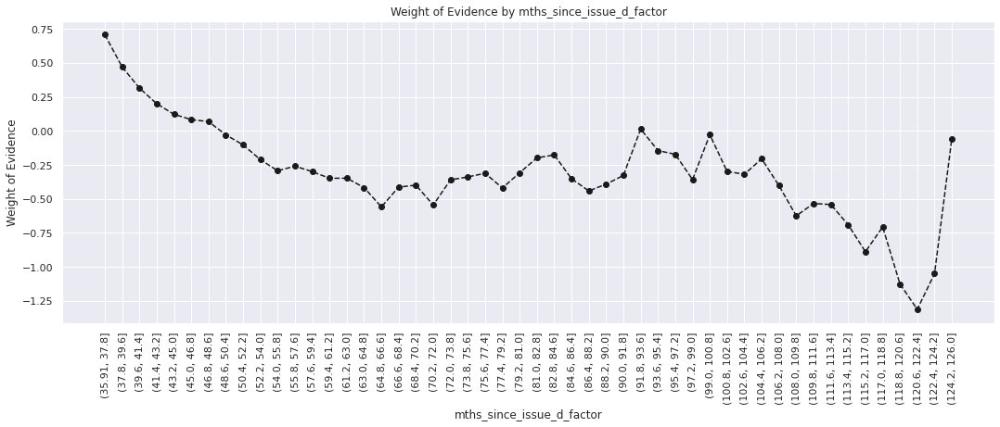

In [44]:
plot_by_woe(df_temp, 90)

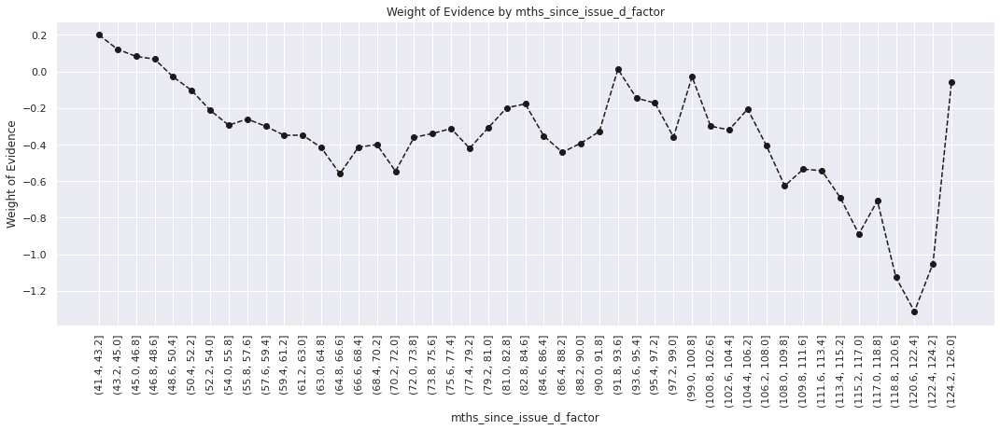

In [45]:
# Some more drill-down for better perspective.
plot_by_woe(df_temp.iloc[3: , : ], 90)

In [46]:
# We create the following categories:
# < 38, 38 - 39, 40 - 41, 42 - 48, 49 - 52, 53 - 64, 65 - 84, > 84.

loan_data['mths_since_issue_d:<38'] = np.where(loan_data['mths_since_issue_d'].isin(range(38)), 1, 0)
loan_data['mths_since_issue_d:38-39'] = np.where(loan_data['mths_since_issue_d'].isin(range(38, 40)), 1, 0)
loan_data['mths_since_issue_d:40-41'] = np.where(loan_data['mths_since_issue_d'].isin(range(40, 42)), 1, 0)
loan_data['mths_since_issue_d:42-48'] = np.where(loan_data['mths_since_issue_d'].isin(range(42, 49)), 1, 0)
loan_data['mths_since_issue_d:49-52'] = np.where(loan_data['mths_since_issue_d'].isin(range(49, 53)), 1, 0)
loan_data['mths_since_issue_d:53-64'] = np.where(loan_data['mths_since_issue_d'].isin(range(53, 65)), 1, 0)
loan_data['mths_since_issue_d:65-84'] = np.where(loan_data['mths_since_issue_d'].isin(range(65, 85)), 1, 0)
loan_data['mths_since_issue_d:>84'] = np.where(loan_data['mths_since_issue_d'].isin(range(85, int(loan_data['mths_since_issue_d'].max()))), 1, 0)

In [47]:
# For int_rate

loan_data['int_rate_factor'] = pd.cut(loan_data['int_rate'], 50)
df_temp = woe_ordered_continuous(loan_data.drop('good_bad', axis = 1), 'int_rate_factor', loan_data['good_bad'])
df_temp

,int_rate_factor,No. of Observations,int_rate_factor:WoE
0,"(5.399, 5.833]",983,1.171936
1,"(5.833, 6.246]",10545,1.808103
2,"(6.246, 6.658]",9800,1.435895
3,"(6.658, 7.071]",2293,1.331203
4,"(7.071, 7.484]",3947,1.671424
5,"(7.484, 7.897]",15826,1.160515
6,"(7.897, 8.31]",12116,0.839321
7,"(8.31, 8.722]",8274,1.228244
8,"(8.722, 9.135]",11923,0.624882
9,"(9.135, 9.548]",8271,1.260856


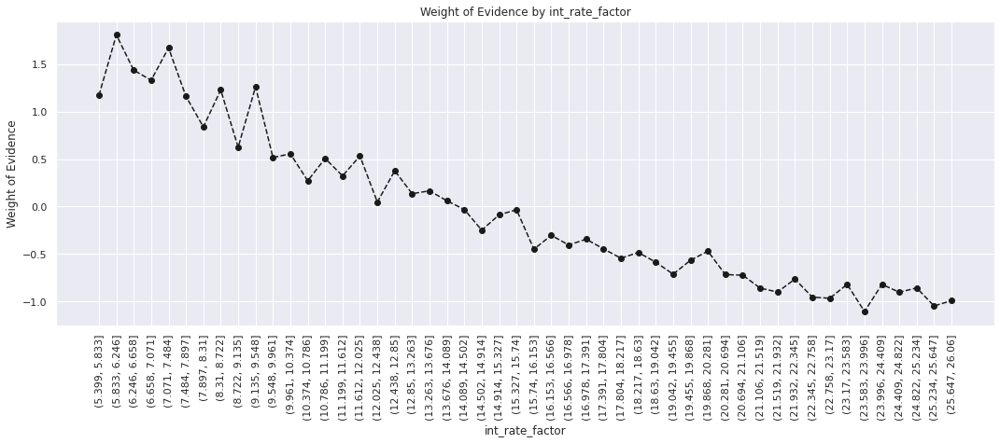

In [48]:
plot_by_woe(df_temp, 90)

In [49]:
# '< 9.548', '9.548 - 12.025', '12.025 - 15.74', '15.74 - 20.281', '> 20.281'

loan_data['int_rate:<9.548'] = np.where((loan_data['int_rate'] <= 9.548), 1, 0)
loan_data['int_rate:9.548-12.025'] = np.where((loan_data['int_rate'] > 9.548) & (loan_data['int_rate'] <= 12.025), 1, 0)
loan_data['int_rate:12.025-15.74'] = np.where((loan_data['int_rate'] > 12.025) & (loan_data['int_rate'] <= 15.74), 1, 0)
loan_data['int_rate:15.74-20.281'] = np.where((loan_data['int_rate'] > 15.74) & (loan_data['int_rate'] <= 20.281), 1, 0)
loan_data['int_rate:>20.281'] = np.where((loan_data['int_rate'] > 20.281), 1, 0)

In [50]:
# For funded_amnt

loan_data['funded_amnt'] = pd.cut(loan_data['funded_amnt'], 50)
df_temp = woe_ordered_continuous(loan_data.drop('good_bad', axis = 1), 'funded_amnt', loan_data['good_bad'])
df_temp

,funded_amnt,No. of Observations,funded_amnt:WoE
0,"(465.5, 1190.0]",1543,0.101543
1,"(1190.0, 1880.0]",3828,0.125188
2,"(1880.0, 2570.0]",7531,0.046087
3,"(2570.0, 3260.0]",9065,-0.006934
4,"(3260.0, 3950.0]",5996,0.009287
5,"(3950.0, 4640.0]",11321,-0.014023
6,"(4640.0, 5330.0]",19860,0.027618
7,"(5330.0, 6020.0]",21422,0.169913
8,"(6020.0, 6710.0]",8632,-0.042674
9,"(6710.0, 7400.0]",14686,0.067705


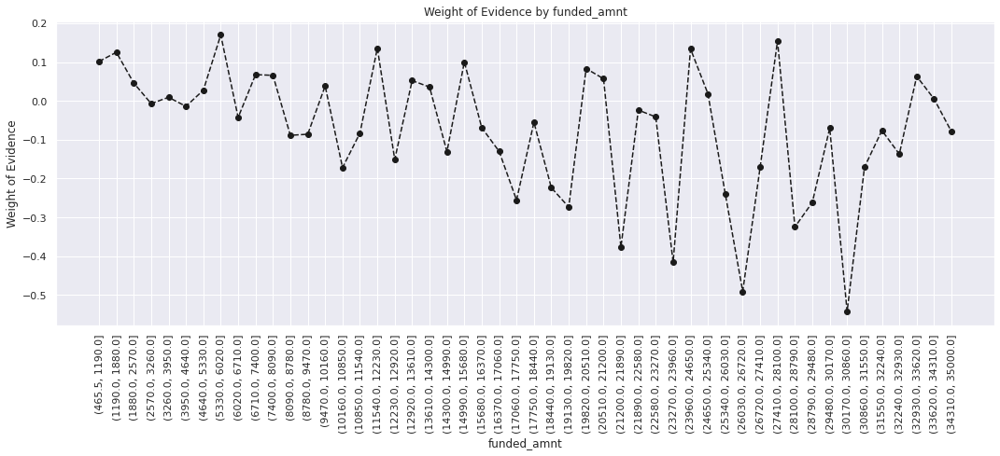

In [51]:
plot_by_woe(df_temp, 90)

# NOTE that there seems to be no definitive relationship
# between WoE and funded_amnt. Hence, it can be overlooked
# in any model later on.

### [Video 35.] Data Preparation: Continuous Variables, Part 1 and 2: Homework

In [52]:
# mths_since_earliest_cr_line

loan_data['mths_since_earliest_cr_line_factor'] = pd.cut(loan_data['mths_since_earliest_cr_line'], 50)
df_temp = woe_ordered_continuous(loan_data.drop('good_bad', axis = 1), 'mths_since_earliest_cr_line_factor', loan_data['good_bad'])
df_temp

,mths_since_earliest_cr_line_factor,No. of Observations,mths_since_earliest_cr_line_factor:WoE
0,"(72.486, 83.28]",1065,0.158130
1,"(83.28, 93.56]",2276,-0.014438
2,"(93.56, 103.84]",2972,-0.301756
3,"(103.84, 114.12]",4969,-0.200489
4,"(114.12, 124.4]",8393,-0.233168
5,"(124.4, 134.68]",11090,-0.280602
6,"(134.68, 144.96]",13533,-0.185538
7,"(144.96, 155.24]",15851,-0.123731
8,"(155.24, 165.52]",18041,-0.090142
9,"(165.52, 175.8]",20687,-0.056232


In [53]:
# plot_by_woe(df_temp, 90)
# plot_by_woe(df_temp.iloc[6: , : ], 90)

In [54]:
# < 140, # 141 - 164, # 165 - 247, # 248 - 270, # 271 - 352, # > 352

loan_data['mths_since_earliest_cr_line:<140'] = np.where(loan_data['mths_since_earliest_cr_line'].isin(range(140)), 1, 0)
loan_data['mths_since_earliest_cr_line:141-164'] = np.where(loan_data['mths_since_earliest_cr_line'].isin(range(140, 165)), 1, 0)
loan_data['mths_since_earliest_cr_line:165-247'] = np.where(loan_data['mths_since_earliest_cr_line'].isin(range(165, 248)), 1, 0)
loan_data['mths_since_earliest_cr_line:248-270'] = np.where(loan_data['mths_since_earliest_cr_line'].isin(range(248, 271)), 1, 0)
loan_data['mths_since_earliest_cr_line:271-352'] = np.where(loan_data['mths_since_earliest_cr_line'].isin(range(271, 353)), 1, 0)
loan_data['mths_since_earliest_cr_line:>352'] = np.where(loan_data['mths_since_earliest_cr_line'].isin(range(353, int(loan_data['mths_since_earliest_cr_line'].max()))), 1, 0)

In [55]:
# delinq_2yrs

df_temp = woe_ordered_continuous(loan_data.drop('good_bad', axis = 1), 'delinq_2yrs', loan_data['good_bad'])
df_temp

/home/olumide/anaconda3/lib/python3.8/site-packages/pandas/core/algorithms.py:1926: RuntimeWarning:

invalid value encountered in subtract



,delinq_2yrs,No. of Observations,delinq_2yrs:WoE
0,0.0,382954,-0.001085
1,1.0,56224,0.020565
2,2.0,16310,-0.025072
3,3.0,5684,-0.054312
4,4.0,2378,0.057118
5,5.0,1236,-0.023848
6,6.0,629,0.028969
7,7.0,346,-0.171603
8,8.0,177,0.144120
9,9.0,111,0.109435


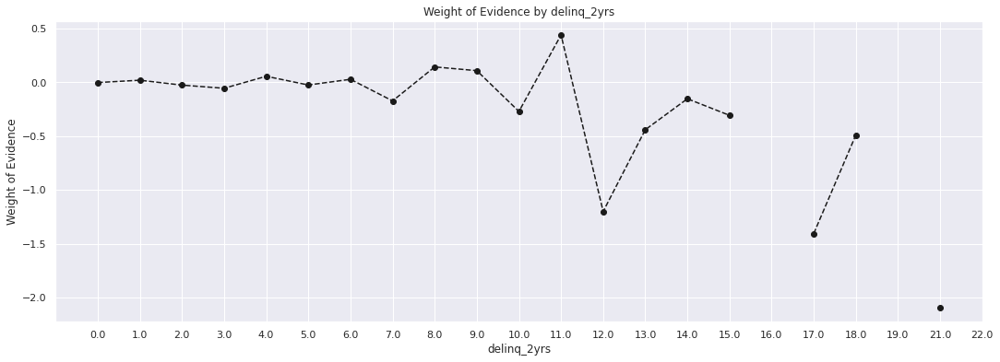

In [56]:
plot_by_woe(df_temp)

In [57]:
# Categories: 0, 1-3, >=4

loan_data['delinq_2yrs:0'] = np.where((loan_data['delinq_2yrs'] == 0), 1, 0)
loan_data['delinq_2yrs:1-3'] = np.where((loan_data['delinq_2yrs'] >= 1) & (loan_data['delinq_2yrs'] <= 3), 1, 0)
loan_data['delinq_2yrs:>=4'] = np.where((loan_data['delinq_2yrs'] >= 4), 1, 0)

In [58]:
# inq_last_6mths

df_temp = woe_ordered_continuous(loan_data.drop('good_bad', axis = 1), 'inq_last_6mths', loan_data['good_bad'])
df_temp

/home/olumide/anaconda3/lib/python3.8/site-packages/pandas/core/series.py:679: RuntimeWarning:

divide by zero encountered in log

/home/olumide/anaconda3/lib/python3.8/site-packages/pandas/core/algorithms.py:1926: RuntimeWarning:

invalid value encountered in subtract



,inq_last_6mths,No. of Observations,inq_last_6mths:WoE
0,0.0,241498,0.200462
1,1.0,130148,-0.062683
2,2.0,57825,-0.252274
3,3.0,25126,-0.432143
4,4.0,7241,-0.386713
5,5.0,2768,-0.523539
6,6.0,1188,-0.810657
7,7.0,195,-1.473161
8,8.0,122,-1.595748
9,9.0,50,-1.522476


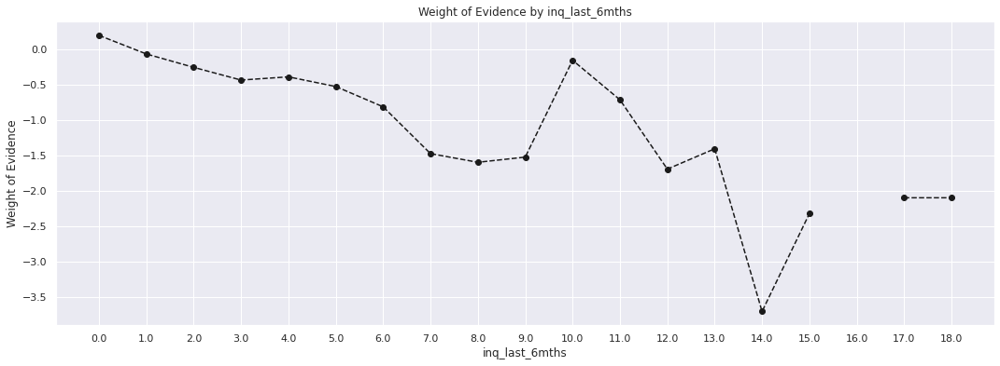

In [59]:
plot_by_woe(df_temp)

In [60]:
# Categories: 0, 1 - 2, 3 - 6, > 6

loan_data['inq_last_6mths:0'] = np.where((loan_data['inq_last_6mths'] == 0), 1, 0)
loan_data['inq_last_6mths:1-2'] = np.where((loan_data['inq_last_6mths'] >= 1) & (loan_data['inq_last_6mths'] <= 2), 1, 0)
loan_data['inq_last_6mths:3-6'] = np.where((loan_data['inq_last_6mths'] >= 3) & (loan_data['inq_last_6mths'] <= 6), 1, 0)
loan_data['inq_last_6mths:>6'] = np.where((loan_data['inq_last_6mths'] > 6), 1, 0)

In [61]:
# open_acc

df_temp = woe_ordered_continuous(loan_data.drop('good_bad', axis = 1), 'open_acc', loan_data['good_bad'])
df_temp

/home/olumide/anaconda3/lib/python3.8/site-packages/pandas/core/series.py:679: RuntimeWarning:

divide by zero encountered in log

/home/olumide/anaconda3/lib/python3.8/site-packages/pandas/core/algorithms.py:1926: RuntimeWarning:

invalid value encountered in subtract



,open_acc,No. of Observations,open_acc:WoE
0,0.0,7,-2.385522
1,1.0,142,-0.167931
2,2.0,1790,-0.408525
3,3.0,5500,-0.201696
4,4.0,12588,0.009792
5,5.0,21544,0.006169
6,6.0,30837,0.013965
7,7.0,37602,-0.000776
8,8.0,41893,0.008411
9,9.0,44019,-0.017248


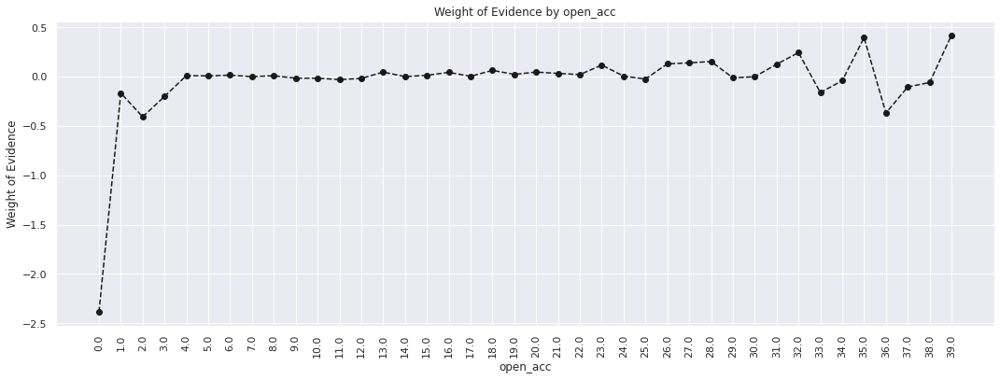

In [62]:
# plot_by_woe(df_temp, 90)
plot_by_woe(df_temp.iloc[ : 40, :], 90)

In [63]:
# Categories: '0', '1-3', '4-12', '13-17', '18-22', '23-25', '26-30', '>30'

loan_data['open_acc:0'] = np.where((loan_data['open_acc'] == 0), 1, 0)
loan_data['open_acc:1-3'] = np.where((loan_data['open_acc'] >= 1) & (loan_data['open_acc'] <= 3), 1, 0)
loan_data['open_acc:4-12'] = np.where((loan_data['open_acc'] >= 4) & (loan_data['open_acc'] <= 12), 1, 0)
loan_data['open_acc:13-17'] = np.where((loan_data['open_acc'] >= 13) & (loan_data['open_acc'] <= 17), 1, 0)
loan_data['open_acc:18-22'] = np.where((loan_data['open_acc'] >= 18) & (loan_data['open_acc'] <= 22), 1, 0)
loan_data['open_acc:23-25'] = np.where((loan_data['open_acc'] >= 23) & (loan_data['open_acc'] <= 25), 1, 0)
loan_data['open_acc:26-30'] = np.where((loan_data['open_acc'] >= 26) & (loan_data['open_acc'] <= 30), 1, 0)
loan_data['open_acc:>=31'] = np.where((loan_data['open_acc'] >= 31), 1, 0)

In [64]:
# pub_rec

df_temp = woe_ordered_continuous(loan_data.drop('good_bad', axis = 1), 'pub_rec', loan_data['good_bad'])
df_temp

/home/olumide/anaconda3/lib/python3.8/site-packages/pandas/core/algorithms.py:1926: RuntimeWarning:

invalid value encountered in subtract



,pub_rec,No. of Observations,pub_rec:WoE
0,0.0,404893,-0.009261
1,1.0,53051,0.044693
2,2.0,5624,0.138314
3,3.0,1611,0.293976
4,4.0,520,0.211107
5,5.0,276,0.208737
6,6.0,136,0.435856
7,7.0,62,0.335773
8,8.0,29,1.234364
9,9.0,16,-0.631503


In [65]:
plotter(df_temp)

In [66]:
# Categories '0-2', '3-4', '>=5'

loan_data['pub_rec:0-2'] = np.where((loan_data['pub_rec'] >= 0) & (loan_data['pub_rec'] <= 2), 1, 0)
loan_data['pub_rec:3-4'] = np.where((loan_data['pub_rec'] >= 3) & (loan_data['pub_rec'] <= 4), 1, 0)
loan_data['pub_rec:>=5'] = np.where((loan_data['pub_rec'] >= 5), 1, 0)

In [67]:
# total_acc

loan_data['total_acc_factor'] = pd.cut(loan_data['total_acc'], 50)
df_temp = woe_ordered_continuous(loan_data.drop('good_bad', axis = 1), 'total_acc', loan_data['good_bad'])
df_temp

/home/olumide/anaconda3/lib/python3.8/site-packages/pandas/core/algorithms.py:1926: RuntimeWarning:

invalid value encountered in subtract



,total_acc,No. of Observations,total_acc:WoE
0,1.0,21,-0.650921
1,2.0,62,-1.041788
2,3.0,472,-0.679458
3,4.0,1504,-0.370522
4,5.0,2387,-0.260878
5,6.0,3612,-0.224600
6,7.0,4850,-0.195970
7,8.0,6280,-0.182159
8,9.0,7632,-0.145927
9,10.0,9177,-0.130716


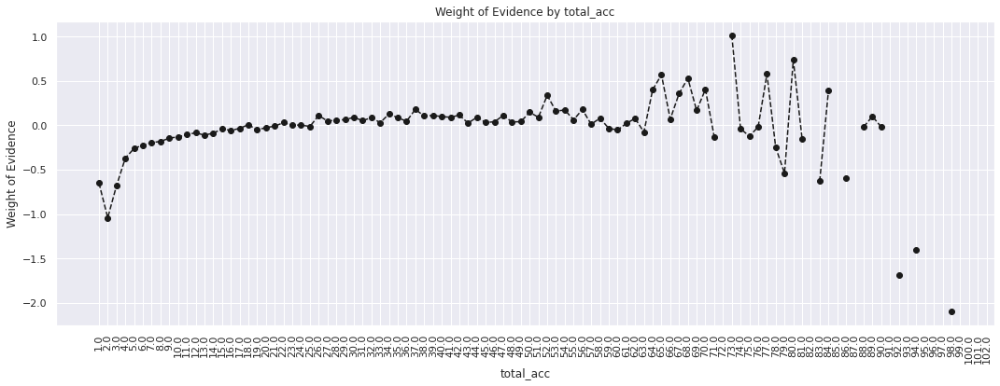

In [68]:
plot_by_woe(df_temp, 90)

In [69]:
# Categories: '<=27', '28-51', '>51'

loan_data['total_acc:<=27'] = np.where((loan_data['total_acc'] <= 27), 1, 0)
loan_data['total_acc:28-51'] = np.where((loan_data['total_acc'] >= 28) & (loan_data['total_acc'] <= 51), 1, 0)
loan_data['total_acc:>=52'] = np.where((loan_data['total_acc'] >= 52), 1, 0)